In [1]:
import clr
clr.AddReference(r"..\..\bin\MiniSim.Core")
clr.AddReference(r"..\..\bin\MiniSim.FlowsheetDrawing")

import MiniSim.Core.Expressions as expr
from  MiniSim.Core.Flowsheeting import MaterialStream, Flowsheet,IconTypes,PortNormal
from  MiniSim.Core.Flowsheeting.Documentation import SpreadsheetElement
import MiniSim.Core.Numerics as num
from MiniSim.Core.UnitsOfMeasure import Unit, SI, METRIC, PhysicalDimension
from MiniSim.Core.ModelLibrary import Flash, Heater, Mixer, Splitter, EquilibriumStageSection,Source,Sink
import MiniSim.Core.PropertyDatabase as chemsep
from MiniSim.Core.Reporting import Generator, StringBuilderLogger
from MiniSim.Core.Thermodynamics import ThermodynamicSystem
from MiniSim.FlowsheetDrawing import FlowsheetDrawer, DrawingOptions

Database = chemsep.ChemSepAdapter()
logger = StringBuilderLogger();
reporter = Generator(logger)

import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import networkx as nx  
from IPython.display import Image as render

In [2]:
import feat
import random
random.seed(89476)

In [3]:
kmolh=Unit.Make([SI.kmol],[SI.h])
tonh=Unit.Make([METRIC.ton],[SI.h])

In [4]:

def appendUnit(genotype, lastUnit, lastPort,depth):
    ucounter= len(genotype["UnitGenes"])+1
    scounter= len(genotype["StreamGenes"])+1
    
    utype= random.randint(1,10)
    newId=f"U{ucounter}"
    newSid=f"S{scounter}"
    
    print(f"At depth {depth}, next unit is a {utype}")
    if(depth==0 or (utype>=1 and utype<=2)):
        genotype["UnitGenes"].append(   
        {
            "ID":newId,
            "Class":"Product",
             "IsMandatory":False,
             "Parameters":[]                       
        })
        genotype["StreamGenes"].append(
            {"ID":newSid, "From":(lastUnit,lastPort), "To":(newId,"In")},
        )
        return
    if (utype>=3 and utype<=7):
        genotype["UnitGenes"].append(   
        {
            "ID":newId,
            "Class":"Flash",
             "IsMandatory":False,
             "Parameters":[
                {"Name":"VF","Value":0.5,"Min":0.2,"Max":0.8,"UoM": SI.none},
                {"Name":"P","Value":1000,"UoM": METRIC.mbar},
             ]                       
        })
        genotype["StreamGenes"].append(
            {"ID":newSid, "From":(lastUnit,lastPort), "To":(newId,"In")}
        )
        depth=depth-1
        appendUnit(genotype,newId,"Vap",depth)
        appendUnit(genotype,newId,"Liq",depth)
        return
    if (utype>=8 and utype<=10):
        su= random.randint(3,20)
        sl= random.randint(3,20)
        genotype["UnitGenes"].append(   
        {
            "ID":newId,
            "Class":"Column",
            "IsMandatory":False,
            "FeedLoc":su+1,
            "Stages":su+sl+1,
            "Parameters":[
               {"Name":"K","Value":0.5,"Min":0.2,"Max":0.8,"UoM": SI.none},
               {"Name":"VF","Value":0.5,"UoM": SI.none}
             ]                       
        })
        genotype["StreamGenes"].append(
            {"ID":newSid, "From":(lastUnit,lastPort), "To":(newId,"In")}
        )
        depth=depth-1
        appendUnit(genotype,newId+"_RS","Out1",depth)
        appendUnit(genotype,newId+"_REB","Liq",depth)
        return
    return
            

def generateGenotype(depth):
    genotype={
    "Generation":1,
    "ID":1,
    "UnitGenes":[],
    "StreamGenes":[]}
    
    genotype["UnitGenes"].append( 
        {
            "ID":"U1",
            "Class":"Feed",
            "IsMandatory":True,
            "Parameters":[ 
                {"Name":"n","Value":100,"UoM": kmolh},
                {"Name":"T","Value":298,"UoM": SI.K},
                {"Name":"P","Value":370,"UoM": METRIC.mbar},
                {"Name":"x[A]","Value":0.3,"UoM": SI.none},
                {"Name":"x[B]","Value":0.3,"UoM": SI.none},
                {"Name":"x[C]","Value":0.2,"UoM": SI.none},
                {"Name":"x[D]","Value":0.2,"UoM": SI.none},
            ]
        })
    
    
    appendUnit(genotype, "U1","Out",depth)
    
    return genotype

In [5]:
sys= ThermodynamicSystem("Test2","NRTL", "default")
sys.AddComponent(Database.FindComponent("Benzene").RenameID("A"))
sys.AddComponent(Database.FindComponent("Toluene").RenameID("B"))
sys.AddComponent(Database.FindComponent("P-xylene").RenameID("C"))
sys.AddComponent(Database.FindComponent("O-xylene").RenameID("D"))
Database.FillBIPs(sys)



In [6]:
genotype=generateGenotype(5)
genotype

At depth 5, next unit is a 4
At depth 4, next unit is a 8
At depth 3, next unit is a 3
At depth 2, next unit is a 1
At depth 2, next unit is a 7
At depth 1, next unit is a 4
At depth 0, next unit is a 5
At depth 0, next unit is a 1
At depth 1, next unit is a 8
At depth 0, next unit is a 9
At depth 0, next unit is a 5
At depth 3, next unit is a 9
At depth 2, next unit is a 9
At depth 1, next unit is a 7
At depth 0, next unit is a 6
At depth 0, next unit is a 6
At depth 1, next unit is a 7
At depth 0, next unit is a 2
At depth 0, next unit is a 10
At depth 2, next unit is a 2
At depth 4, next unit is a 9
At depth 3, next unit is a 9
At depth 2, next unit is a 5
At depth 1, next unit is a 7
At depth 0, next unit is a 1
At depth 0, next unit is a 9
At depth 1, next unit is a 5
At depth 0, next unit is a 4
At depth 0, next unit is a 4
At depth 2, next unit is a 6
At depth 1, next unit is a 5
At depth 0, next unit is a 1
At depth 0, next unit is a 7
At depth 1, next unit is a 2
At depth 3, n

{'Generation': 1,
 'ID': 1,
 'UnitGenes': [{'ID': 'U1',
   'Class': 'Feed',
   'IsMandatory': True,
   'Parameters': [{'Name': 'n',
     'Value': 100,
     'UoM': <MiniSim.Core.UnitsOfMeasure.Unit at 0x2af1a3f7ec8>},
    {'Name': 'T',
     'Value': 298,
     'UoM': <MiniSim.Core.UnitsOfMeasure.Unit at 0x2af1a409b88>},
    {'Name': 'P',
     'Value': 370,
     'UoM': <MiniSim.Core.UnitsOfMeasure.Unit at 0x2af1a409208>},
    {'Name': 'x[A]',
     'Value': 0.3,
     'UoM': <MiniSim.Core.UnitsOfMeasure.Unit at 0x2af1a409888>},
    {'Name': 'x[B]',
     'Value': 0.3,
     'UoM': <MiniSim.Core.UnitsOfMeasure.Unit at 0x2af1a409d48>},
    {'Name': 'x[C]',
     'Value': 0.2,
     'UoM': <MiniSim.Core.UnitsOfMeasure.Unit at 0x2af1a409a48>},
    {'Name': 'x[D]',
     'Value': 0.2,
     'UoM': <MiniSim.Core.UnitsOfMeasure.Unit at 0x2af1a428d08>}]},
  {'ID': 'U2',
   'Class': 'Flash',
   'IsMandatory': False,
   'Parameters': [{'Name': 'VF',
     'Value': 0.5,
     'Min': 0.2,
     'Max': 0.8,
    

In [7]:
phenotype=feat.Genotype2Phenotype(genotype,sys)

In [8]:
feat.AutomaticLayout(phenotype)

In [9]:

options=DrawingOptions()
options.ShowStreamWidth=False
options.ShowPressure=False
options.ShowMassFlow=False
options.ShowTemperature=False
options.ShowStreamColors=False
#render(feat.convertFlowsheet(phenotype,options))

In [10]:
def EvaluatePhenotype(phenotype):
    f=-1e20
    G, seq,scc= feat.sequenceFlowsheet(phenotype)
    print(f"## Init step")
    for sc in list(scc):
        print(sc) 
    for u in list(seq):
        print(u)        
    feat.initializeFlowsheet(phenotype, seq, 2,False)
    print(f"## Solve step")
    feat.initializeFlowsheet(phenotype, seq,1, True)    
    feat.solve(phenotype)
    #report(phenotype)
    puritiesA=[]
    puritiesB=[]
    puritiesC=[]
    puritiesD=[]
    for u in phenotype.Units:
        if(u.Class=="Sink"):
            s=u.FindMaterialPort("In").Streams[0]
            puritiesA.append(s.GetVariable('x[A]').DisplayValue)
            puritiesB.append(s.GetVariable('x[B]').DisplayValue)
            puritiesC.append(s.GetVariable('x[C]').DisplayValue)    
            puritiesD.append(s.GetVariable('x[D]').DisplayValue)    
    f=max(puritiesA)+max(puritiesB)+max(puritiesC)+max(puritiesD)
    return f

In [11]:
EvaluatePhenotype(phenotype)

## Init step
{'U1'}
{'U2'}
{'U22', 'U22_COND', 'U22_REB', 'U22_RS'}
{'U36'}
{'U42'}
{'U46'}
{'U43'}
{'U45'}
{'U44'}
{'U37_COND', 'U37', 'U37_REB', 'U37_RS'}
{'U41'}
{'U38'}
{'U40'}
{'U39'}
{'U23_COND', 'U23_RS', 'U23', 'U23_REB'}
{'U31'}
{'U35'}
{'U32'}
{'U34'}
{'U33'}
{'U24'}
{'U28'}
{'U30'}
{'U29'}
{'U25'}
{'U27'}
{'U26'}
{'U3_REB', 'U3_COND', 'U3', 'U3_RS'}
{'U13', 'U13_COND', 'U13_RS', 'U13_REB'}
{'U21'}
{'U14_RS', 'U14_REB', 'U14', 'U14_COND'}
{'U18'}
{'U20'}
{'U19'}
{'U15'}
{'U17'}
{'U16'}
{'U4'}
{'U6'}
{'U10', 'U10_COND', 'U10_RS', 'U10_REB'}
{'U12'}
{'U11'}
{'U7'}
{'U9'}
{'U8'}
{'U5'}
U1
U2
U22
U22_COND
U22_REB
U22_RS
U36
U42
U46
U43
U45
U44
U37
U37_COND
U37_REB
U37_RS
U41
U38
U40
U39
U23
U23_COND
U23_RS
U23_REB
U31
U35
U32
U34
U33
U24
U28
U30
U29
U25
U27
U26
U3
U3_REB
U3_COND
U3_RS
U13
U13_COND
U13_RS
U13_REB
U21
U14
U14_REB
U14_COND
U14_RS
U18
U20
U19
U15
U17
U16
U4
U6
U10
U10_COND
U10_RS
U10_REB
U12
U11
U7
U9
U8
U5
## iteration 0
Unit U1 initialized
Unit U2 initialized
Unit 

2.7967444000946458

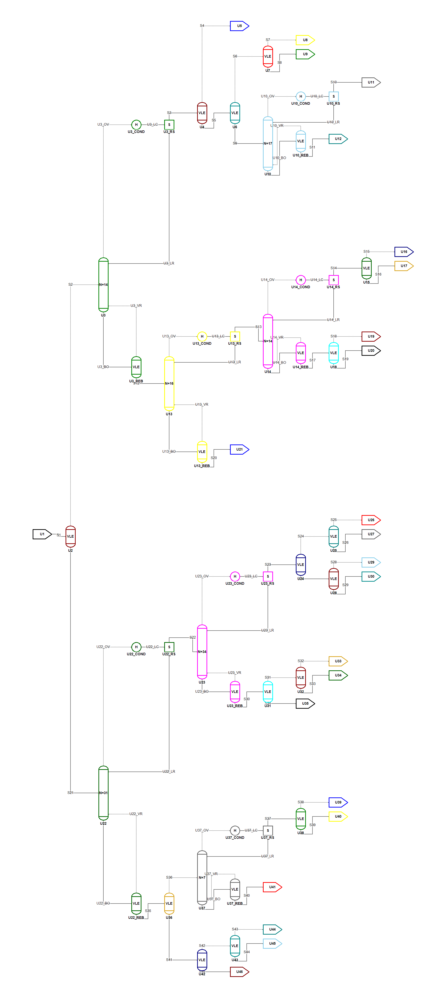

In [12]:
G, seq,scc= feat.sequenceFlowsheet(phenotype)
    
colors=["Black",
"DarkRed",
"DarkGreen",
"Goldenrod",
"Navy",
"Maroon",
"DarkCyan",
"SkyBlue",
"Teal",
"DimGray",
"Red",
"Green",
"Yellow",
"Blue",
"Magenta",
"Cyan"]

for i, sc in enumerate(list(scc)):
    for n in list(sc):
        phenotype.GetUnit(n).SetColors(colors[i%len(colors)],colors[i%len(colors)])     
render(feat.convertFlowsheet(phenotype,options))        

In [13]:
reporter.Report(phenotype,4,False)
print(logger.Flush())


Report for flowsheet Individual_Gen1:1

Material Streams

System                    Test2      

Property                  Unit              U3_OV        U3_LC        U3_LR        U3_BO

Temperature               °C              96.2500      88.6790      88.6790     125.9935
Pressure                  mbar          1000.0000    1000.0000    1000.0000    1000.0000
Vapor Fraction            mol/mol          1.0000       0.0000       0.0000       0.0000
Specific Enthalpy         kJ/kmol       7301.2457  -25522.0555  -25522.0555  -21412.0387
Phase                                       Vapor  BubblePoint       Liquid  LiquidVapor
Density                   kmol/cum         0.0326       9.6056       9.6056       7.6153
Mass Density              kg/cum           2.7267     804.4424     804.4424     772.0751
Volume Flow               cum/h         2132.2092       7.2273       3.6136       4.0153
Molar Weight              kg/kmol         83.7474      83.7474      83.7474     101.3852

Total Mola